# Severstaal Steel Defect Detection 
In this notebook I'm trying to build the best model I can for solving steel defect detection problem. The problem was published by Severstaal in Kaggle as a competition. Related data and further information can be found in the [competition's kaggle page](https://www.kaggle.com/c/severstal-steel-defect-detection?rvi=1)

# Data Wrangling
This section will focus on what given and question these:
1. Are all images the same size?
2. What else provided?
3. What kind of problem is this?
4. Does any preprocessing required?
5. Does all train images have defects?

In [1]:
# imports
import numpy as np
import pandas as pd
import cv2 as cv
import matplotlib.pyplot as plt
import random
import os

# for reproducibility
RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
random.seed(RANDOM_SEED)

plt.style.use('fivethirtyeight')

---
**1. Are all images the same size?**

In [2]:
train_folder_path = "/kaggle/input/severstal-steel-defect-detection/train_images/"
test_folder_path = "/kaggle/input/severstal-steel-defect-detection/test_images/"

In [3]:
# Check all images sizes
train_images_paths = np.array(
    train_folder_path + 
    np.array(os.listdir(train_folder_path), 
             dtype='O')
)

test_images_paths = np.array(
    test_folder_path + 
    np.array(os.listdir(test_folder_path),
             dtype='O'))

all_images = np.append(train_images_paths, test_images_paths)

shapes = set()

# This part takes some time. So one run is enough to see if
# the images are at the same shape
# for i in all_images:
#     img = cv.imread(i)
#     shapes.add(img.shape)


# Print different types of shape if there are any
print(shapes)

set()


All the given images are at the same size  

---

**2. What else provided?**  
There are two CSV files one `sample_submission` and the other `train_csv`.  

Sample submission is just an example for how the final submission has to be.

In [4]:
sample_submission = pd.read_csv('/kaggle/input/severstal-steel-defect-detection/sample_submission.csv')

sample_submission.head()

,ImageId,EncodedPixels,ClassId
0,0000f269f.jpg,1 409600,0
1,000ccc2ac.jpg,1 409600,0
2,002451917.jpg,1 409600,0
3,003c5da97.jpg,1 409600,0
4,0042e163f.jpg,1 409600,0


A good understanding of the `train.csv` is crucial

In [5]:
train_csv = pd.read_csv('/kaggle/input/severstal-steel-defect-detection/train.csv')

train_csv.head()

,ImageId,ClassId,EncodedPixels
0,0002cc93b.jpg,1,29102 12 29346 24 29602 24 29858 24 30114 24 3...
1,0007a71bf.jpg,3,18661 28 18863 82 19091 110 19347 110 19603 11...
2,000a4bcdd.jpg,1,37607 3 37858 8 38108 14 38359 20 38610 25 388...
3,000f6bf48.jpg,4,131973 1 132228 4 132483 6 132738 8 132993 11 ...
4,0014fce06.jpg,3,229501 11 229741 33 229981 55 230221 77 230468...


In [6]:
train_csv.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7095 entries, 0 to 7094
Data columns (total 3 columns):
 #   Column         Non-Null Count  Dtype 
---  ------         --------------  ----- 
 0   ImageId        7095 non-null   object
 1   ClassId        7095 non-null   int64 
 2   EncodedPixels  7095 non-null   object
dtypes: int64(1), object(2)
memory usage: 166.4+ KB


In [7]:
# Can `ClassId` contain more than one class?
train_csv['ClassId'].unique()

array([1, 3, 4, 2])

No, each row represents one type of class. Besides that, not having any null entries provides that all images in the training set contains at least one defect

In [8]:
# Are `ImageId`s unique for each row?
len(train_csv['ImageId'].unique())

6666

No, it's not. This means one image can contain more than one defect.

In [9]:
# Encoded Pixels
train_csv['EncodedPixels'].iloc[0]

'29102 12 29346 24 29602 24 29858 24 30114 24 30370 24 30626 24 30882 24 31139 23 31395 23 31651 23 31907 23 32163 23 32419 23 32675 23 77918 27 78174 55 78429 60 78685 64 78941 68 79197 72 79452 77 79708 81 79964 85 80220 89 80475 94 80731 98 80987 102 81242 105 81498 105 81754 104 82010 104 82265 105 82521 31 82556 69 82779 27 82818 63 83038 22 83080 57 83297 17 83342 50 83555 13 83604 44 83814 8 83866 37 84073 3 84128 31 84390 25 84652 18 84918 8 85239 10 85476 29 85714 47 85960 57 86216 57 86471 58 86727 58 86983 58 87238 59 87494 59 87750 59 88005 60 88261 60 88517 60 88772 61 89028 53 89283 40 89539 32 89667 10 89795 30 89923 28 90050 29 90179 37 90306 27 90434 38 90562 14 90690 38 90817 9 90946 38 91073 3 91202 38 91458 38 91714 38 91969 39 92225 39 92481 39 92737 39 92993 39 93248 40 93504 40 93760 40 94026 30 94302 10 189792 7 190034 21 190283 28 190539 28 190795 28 191051 28 191307 28 191563 28 191819 28 192075 28 192331 28 192587 28 192843 23 193099 14 193355 5'

> In order to reduce the submission file size, our metric uses run-length encoding on the pixel values. Instead of submitting an exhaustive list of indices for your segmentation, you will submit pairs of values that contain a start position and a run length. E.g. '1 3' implies starting at pixel 1 and running a total of 3 pixels 1,2,3.

So encoded pixels needs to be build with a function to reveal the pixels with defection

---
**3. What kind of problem is this?**

As described in the challange description this is a classification problem. 

> *Each row in your submission represents a single predicted defect segmentation for the given `ImageId`, and predicted `ClassId`*

As it's said in the evaluation of the competition, this is a [multi-class classification](https://en.wikipedia.org/wiki/Multiclass_classification) problem. However, it also can be solved as [multi-label classification](https://en.wikipedia.org/wiki/Multi-label_classification) then each class found will need to be seperated into rows in submission. Either way it is important if the data is balanced or not

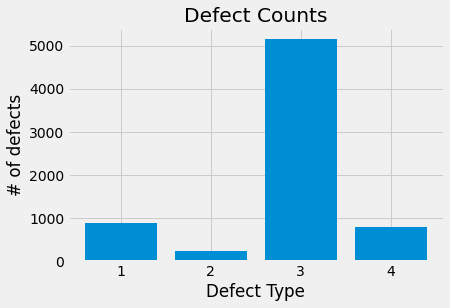

In [10]:
class_counts = train_csv['ClassId'].value_counts()
_ = plt.bar(class_counts.index, class_counts.values)
_ = plt.xlabel("Defect Type")
_ = plt.ylabel("# of defects")
_ = plt.title("Defect Counts")

This is a very imbalanced data.

---
**4. Does any preprocessing required?**

Since all the images are the same shape and having the same number of bands no preprocessing will be prepared.

---
**5. Does all train images have defects?**
There are 6666 individual images given in train CSV file. in total how many train images do we have?

In [11]:
# This, again takes some time to calculate.
# !find /kaggle/input/severstal-steel-defect-detection/train_images -type f | wc -l

So there are images without defect as much as there are with. If the algorithm fed with all of these images, it will tend to predict "without defect" most of the time

# Exploratory Data Analysis

This section will focus on the images with their defects, relations between defects and computer vision algorithms' results on the defects

## Decoding Pixels & Drawing in Images
Encoded pixels are stored as string. Having them as integer will be better for both plotting and training the model

In [12]:
# Run length and start pixels separeted by space
encoded_pixels = train_csv['EncodedPixels'].str.split(' ')

# Convert each str in the array to int and store them 
# in numpy array for better slicing option.
encoded_pixels = encoded_pixels.apply(lambda x: np.asarray([int(i) for i in x]))

# Replace the column of string values with integer values
train_csv['EncodedPixels'] = encoded_pixels

In [13]:
train_csv.head()

,ImageId,ClassId,EncodedPixels
0,0002cc93b.jpg,1,"[29102, 12, 29346, 24, 29602, 24, 29858, 24, 3..."
1,0007a71bf.jpg,3,"[18661, 28, 18863, 82, 19091, 110, 19347, 110,..."
2,000a4bcdd.jpg,1,"[37607, 3, 37858, 8, 38108, 14, 38359, 20, 386..."
3,000f6bf48.jpg,4,"[131973, 1, 132228, 4, 132483, 6, 132738, 8, 1..."
4,0014fce06.jpg,3,"[229501, 11, 229741, 33, 229981, 55, 230221, 7..."


In [14]:
def img_show(image, title=False):
    """OpenCV's cv.imshow has bug on jupyter notebook.
    So the images will be plotted with matplotlib.
    This function will be used to reduce the workload    
    """
    
    height = 256
    width= 1600
    
    # Original shapes are too big to show in
    # the notebook. 
    plt_y = width / 10
    plt_x = height / 10
        
    fig, ax = plt.subplots(figsize=(plt_y, plt_x))
    
    if title:
        ax.set_title(title, fontdict={'fontsize': 100.0,
                                     'fontweight': 'medium'})

    
    ax.axis('off')
    ax.imshow(image)

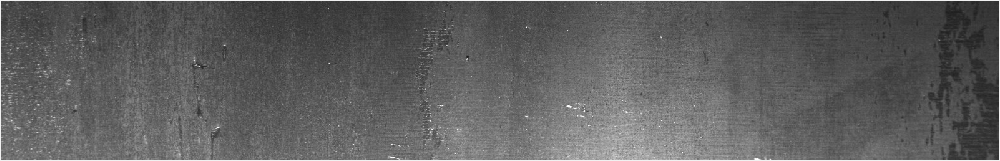

In [15]:
sample_image = cv.imread(train_folder_path + 
                         train_csv.loc[0, 'ImageId'])
img_show(sample_image)

In [16]:
def rle_to_mask(encoded_pixels, width=1600, heigth=256):
    """Converts encoded pixels to mask image
    for further orıcess to show on the image.
    """
    
    # Create an array with the size of images.
    # Which will work as a mask for defects
    mask = np.zeros(width * heigth, dtype='uint8')

    # Seperate the start and end pixels.
    start = np.array(encoded_pixels[::2])
    diff = np.array(encoded_pixels[1::2])
    end = np.add(start, diff)
    

    # Encoded pixel numbers begin at 1 but pyhon indexes start at 0 
    start -= 1
    end -= 1

    # For every start end couple set the related pxels to white.
    for s, e in zip(start, end):
        mask[s:e] = 255
    
    # Numpy and OpenCV handles the widht and height in reverse order.
    # So numpy array needs to be transposed to be the same size with
    # the original image.
    return mask.reshape((width, heigth)).T

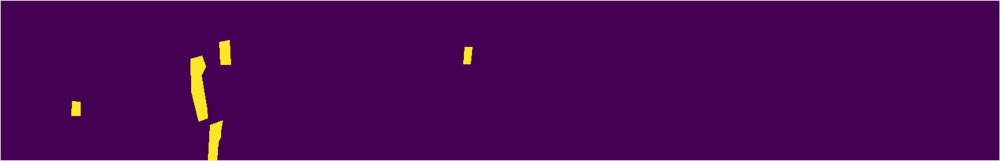

In [17]:
# Mask of sample image
sample_mask = rle_to_mask(train_csv.iloc[0,2])

img_show(sample_mask)

In [18]:
def border_on_image(image, mask, color=(0,255,0)):
    """ Draw only the borders of the masks.
    So that the below defect can be seen easily.
    """
    
    # Best practice for contours is first appliying threshold
    # or canny edge. However mask is already a binary image
    # Further details on params for the function:
    # https://docs.opencv.org/master/d9/d8b/tutorial_py_contours_hierarchy.html
    contours, hierarchy = cv.findContours(mask,
                                         cv.RETR_EXTERNAL, cv.CHAIN_APPROX_NONE)

    # Draw contours on the image
    contour_index = -1 # Draw all contours
    thickness = 1 #Thickness of drawn line
    image_with_borders = cv.drawContours(image, contours, contour_index,
                                        color, thickness) 
    
    
    return image_with_borders

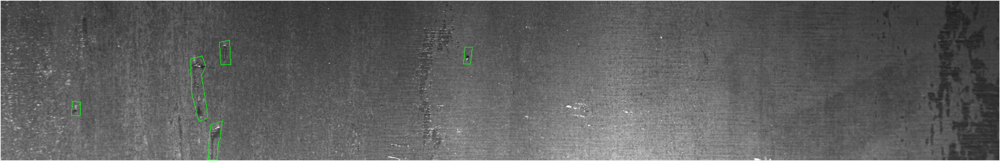

In [19]:
img_with_border = border_on_image(sample_image, sample_mask)

img_show(img_with_border)

## Plotting different types of images

In [20]:
type_one = train_csv[train_csv['ClassId'] == 1].iloc[0]
type_two = train_csv[train_csv['ClassId'] == 2].iloc[0]
type_three = train_csv[train_csv['ClassId'] == 3].iloc[0]
type_four = train_csv[train_csv['ClassId'] == 4].iloc[0]

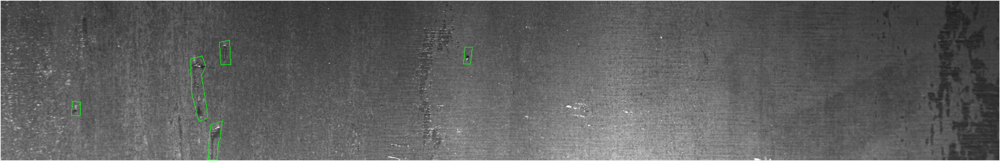

In [21]:
# Plot type one defect

type_one_image = cv.imread(train_folder_path + type_one['ImageId'])

type_one_mask = rle_to_mask(type_one['EncodedPixels'])

img_show(border_on_image(type_one_image, type_one_mask, (0,255,0)))

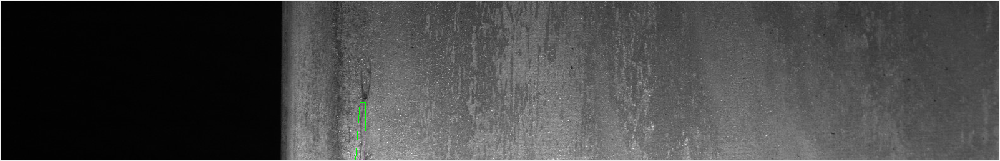

In [22]:
# Plot type two defect

type_two_image = cv.imread(train_folder_path + type_two['ImageId'])

type_two_mask = rle_to_mask(type_two['EncodedPixels'])

img_show(border_on_image(type_two_image, type_two_mask, (0,255,0)))

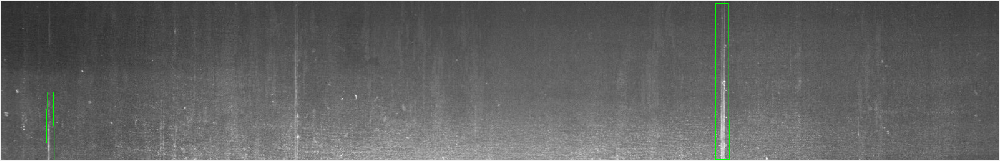

In [23]:
# Plot type three defect

type_three_image = cv.imread(train_folder_path + type_three['ImageId'])

type_three_mask = rle_to_mask(type_three['EncodedPixels'])

img_show(border_on_image(type_three_image, type_three_mask, (0,255,0)))

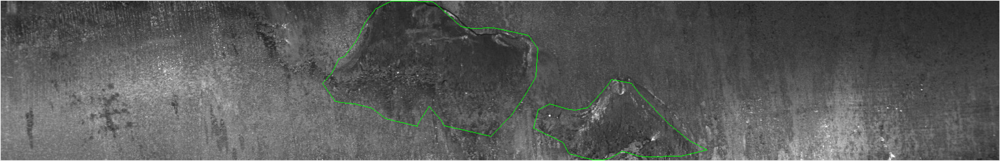

In [24]:
# Plot type four defect

type_four_image = cv.imread(train_folder_path + type_four['ImageId'])

type_four_mask = rle_to_mask(type_four['EncodedPixels'])

img_show(border_on_image(type_four_image, type_four_mask, (0,255,0)))

## Multiple defects on an image

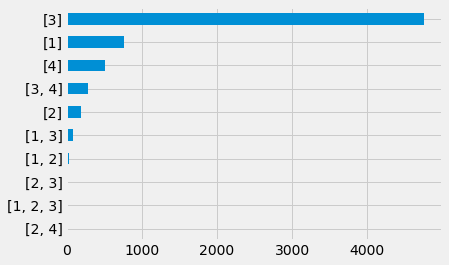

In [25]:
# Pivot the data to sum how many defects appears on images.
# This time if two defects appear on an image count them as 
# another group
pivot = (
    train_csv
    .groupby('ImageId')['ClassId']
    .apply(list)
    .value_counts(ascending=True)
)

_ = pivot.plot(kind='barh')

While each defect can appear on their own they also can apper with any other type. Except, 1 and 4 while they are second and the third most common types they don't seem to appear together.   

---
# Feature Detection
In this section some of OpenCV builtin algorithms will run on the images
Detailed information ca be found in [official tutorial](https://docs.opencv.org/master/db/d27/tutorial_py_table_of_contents_feature2d.html)

## Shi-Tomasi Algorithm

In [26]:
types = [type_one, type_two,
        type_three, type_four]

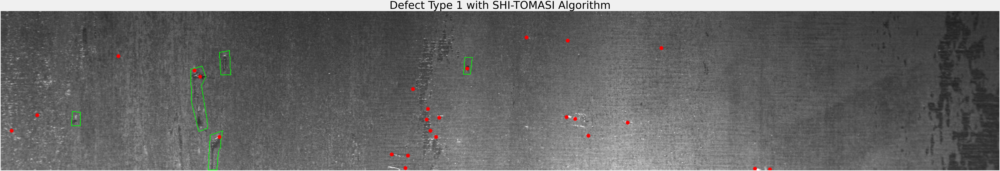

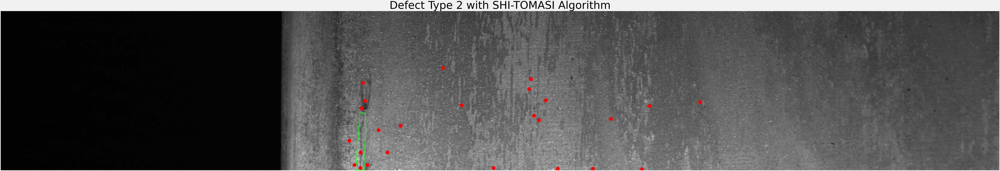

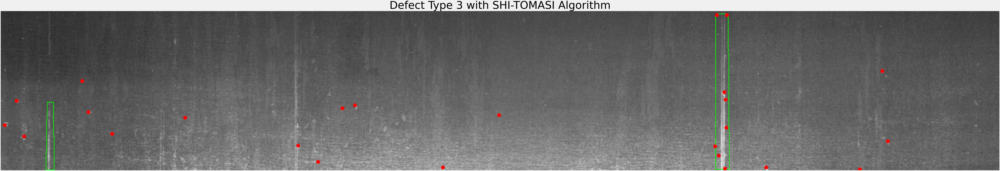

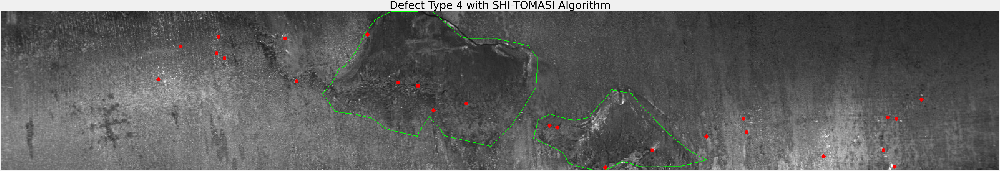

In [27]:
for t in types:
    
    image = cv.imread(train_folder_path + t['ImageId'])
    
    mask = rle_to_mask(t['EncodedPixels'])
    
    image_with_mask = border_on_image(image, mask)
    
    # Initialize SHI-TOMASI with raw image
    gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY) 
    corners = cv.goodFeaturesToTrack(gray, 25, 0.01, 10)
    corners = np.int0(corners)
    

    for i in corners:
        x, y = i.ravel()
        image_shi = cv.circle(image_with_mask, (x,y), 3, 255, -1)
    
    img_show(image_shi, title=f"Defect Type {t['ClassId']} with SHI-TOMASI Algorithm")

Shi-Tomasi doesn't seem to be good at capturing anything specific

---
## SIFT Algorithm

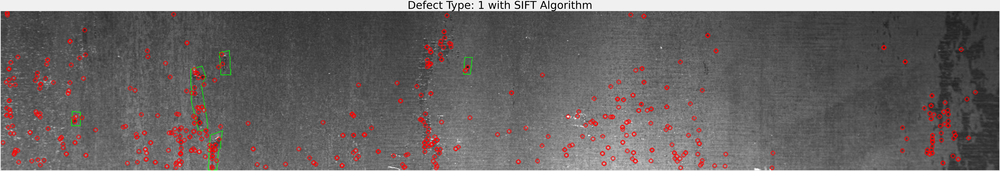

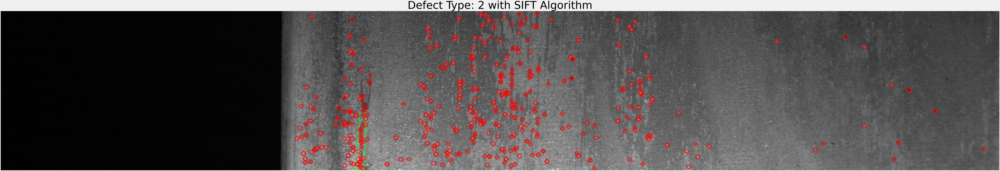

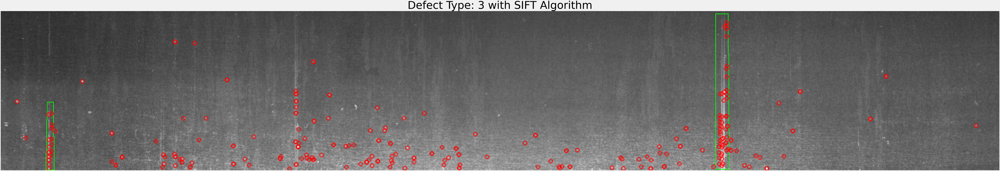

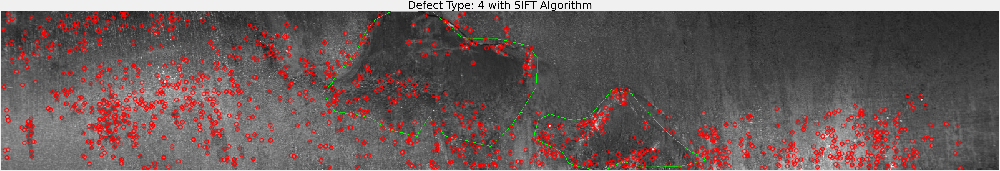

In [28]:
for t in types:
    
    image = cv.imread(train_folder_path + t['ImageId'])
    
    mask = rle_to_mask(t['EncodedPixels'])
    
    image_with_mask = border_on_image(image, mask)
    
    # Initialize SIFT with raw image
    gray = cv.cvtColor(image, cv.COLOR_BGR2GRAY) 
    sift = cv.SIFT_create()
    kp_sift = sift.detect(gray, None)

    # Draw keypoints on image with mask
    image_sift = cv.drawKeypoints(image_with_mask, kp_sift, None, color=(255, 0, 0))

    img_show(image_sift, title=f"Defect Type: {t['ClassId']} with SIFT Algorithm")

SIFTs seems to be catching much  more features. But there are many points outside of the defects as well.

---

## FAST Algorithm

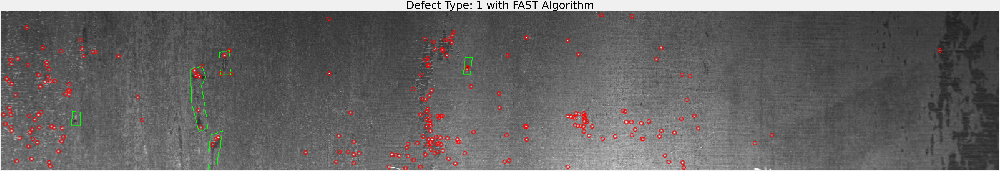

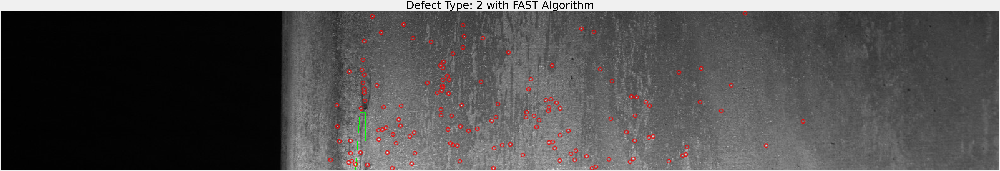

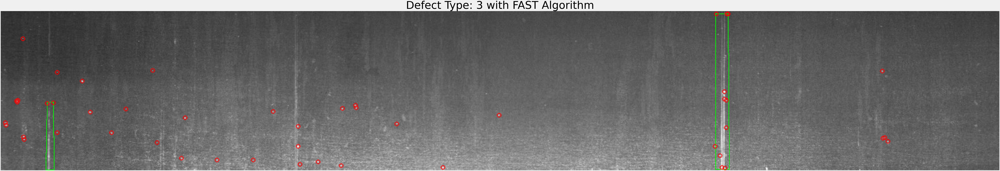

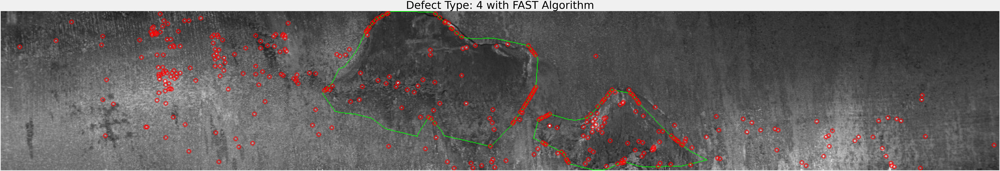

In [29]:
for t in types:
    
    image = cv.imread(train_folder_path + t['ImageId'])
    
    mask = rle_to_mask(t['EncodedPixels'])
    
    image_with_mask = border_on_image(image, mask)
    
    ## Initialize FAST
    fast = cv.FastFeatureDetector_create()
    fast.setThreshold(60)
    fast.setType(cv.FAST_FEATURE_DETECTOR_TYPE_9_16)

    ## Find keypoints on raw image
    kp_fast = fast.detect(image, None)

    ## Draw keypoints on image with mask
    image_fast = cv.drawKeypoints(image_with_mask, kp_fast, None, color=(255, 0, 0))

    img_show(image_fast, title=f"Defect Type: {t['ClassId']} with FAST Algorithm")

FAST seems to be as good as SIFT.

---

## ORB Algorithm

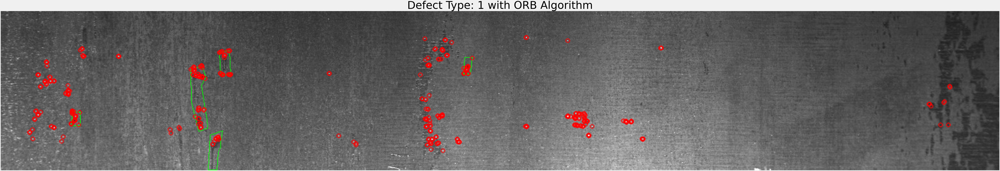

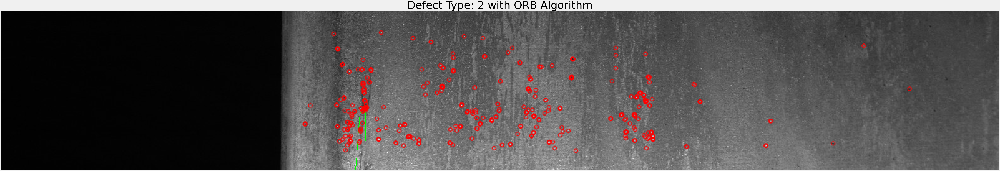

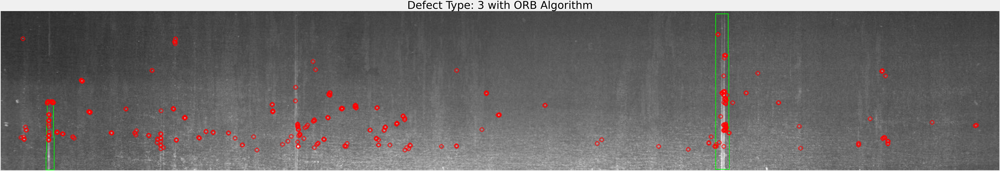

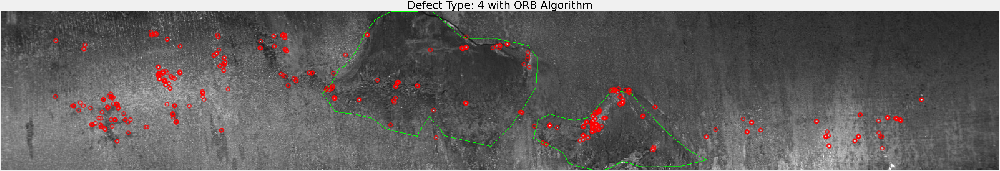

In [30]:
for t in types:
    
    image = cv.imread(train_folder_path + t['ImageId'])
    
    mask = rle_to_mask(t['EncodedPixels'])
    
    image_with_mask = border_on_image(image, mask)
    
    ## Initialize the ORB algorithm
    orb = cv.ORB_create()

    ## Detect the keypoints on raw image
    kp_orb = orb.detect(image, None)

    ## Compute descriptors on raw image
    kp_orb, des = orb.compute(image, kp_orb)

    ## Draw the key point on the image with mask
    image_orb = cv.drawKeypoints(image_with_mask, kp_orb, None, color=255, flags=0)

    img_show(image_orb, title=f"Defect Type: {t['ClassId']} with ORB Algorithm")

Again ORB is not bad. However, there are still some places detected by algoritms and this shows that the detection the defects while exlucing some patterns im the images will be challenging.


In [31]:
mask.shape

(256, 1600)